## Polarisation segmentation on Taurus

In [1]:
import aplpy
from astropy.io import fits
%pylab inline

Populating the interactive namespace from numpy and matplotlib


INFO: Auto-setting vmin to -1.333e-03 [aplpy.core]
INFO: Auto-setting vmax to  2.329e-03 [aplpy.core]
INFO: Auto-setting vmin to -1.099e-03 [aplpy.core]
INFO: Auto-setting vmax to  9.835e-04 [aplpy.core]


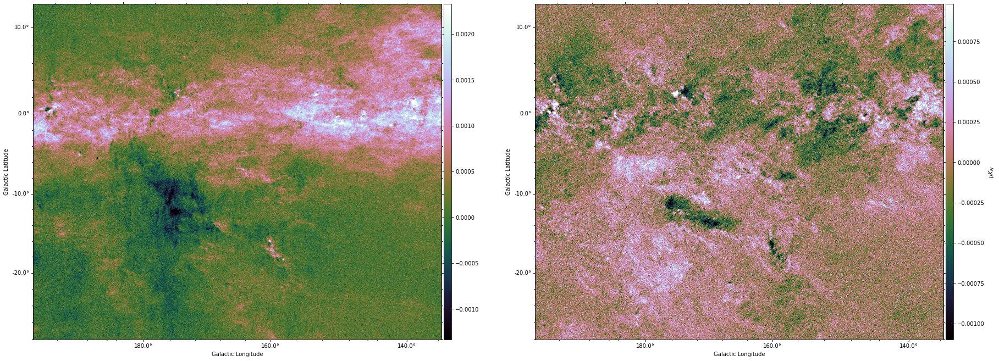

In [2]:
Qfile = '/Users/robitaij/postdoc/Planck/HFI_353_Q_taurus.fits'
Ufile = '/Users/robitaij/postdoc/Planck/HFI_353_U_taurus.fits'

fig_all = plt.figure(1, figsize=(30,30))

fig = aplpy.FITSFigure(Qfile, figure=fig_all, convention='calabretta',subplot=(1, 2, 1))
fig.show_colorscale(cmap='cubehelix')
fig.tick_labels.set_xformat('dd.d')
fig.tick_labels.set_yformat('dd.d')
fig.add_colorbar()

fig = aplpy.FITSFigure(Ufile, figure=fig_all, convention='calabretta',subplot=(1, 2, 2))
fig.show_colorscale(cmap='cubehelix')
fig.tick_labels.set_xformat('dd.d')
fig.tick_labels.set_yformat('dd.d')
fig.add_colorbar()
fig.colorbar.set_axis_label_text(r'$\mu K_{RJ}$')

Load images

In [3]:
QHDU = fits.open(Qfile)
Qim = QHDU[0].data
meanQ = np.mean(Qim)

UHDU = fits.open(Ufile)
Uim = UHDU[0].data
meanU = np.mean(Uim)

In [4]:
from pywavan import fan_trans

In [4]:
#Resolution in arcmin
reso = QHDU[0].header['CDELT2'] * 60.

newsize = np.array([2500,2500])

In [ ]:
#Set a list of q
#qQ=[]
qQ=[2.9]*27

#Wavelet power spectrum
wtQ, S11aQ, wav_k, S1aQ, qQ = fan_trans(Qim, reso=reso, q=qQ, qdyn=True, apodize= 0.97, arrdim = newsize, cutpad=True)

In [5]:
wtQ = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wtQ.npy')
#S11aQ = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S11aQ.npy')
wav_k = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wav_k.npy')
S1aQ = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S1aQ.npy')
qQ = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_qQ.npy')

In [7]:
#Set a list of q
qU=[]
qU=[2.5]*27

#Wavelet power spectrum
wtU, S11aU, wav_k, S1aU, qU = fan_trans(Uim, reso=reso, q=qU, qdyn=True, apodize= 0.97, arrdim = newsize, cutpad=True)

2500 2500


In [6]:
wtU = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wtU.npy')
#S11aU = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S11aU.npy')
S1aU = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S1aU.npy')
qU = np.load('/Users/robitaij/postdoc/pol_seg/analysis/taurus_qU.npy')

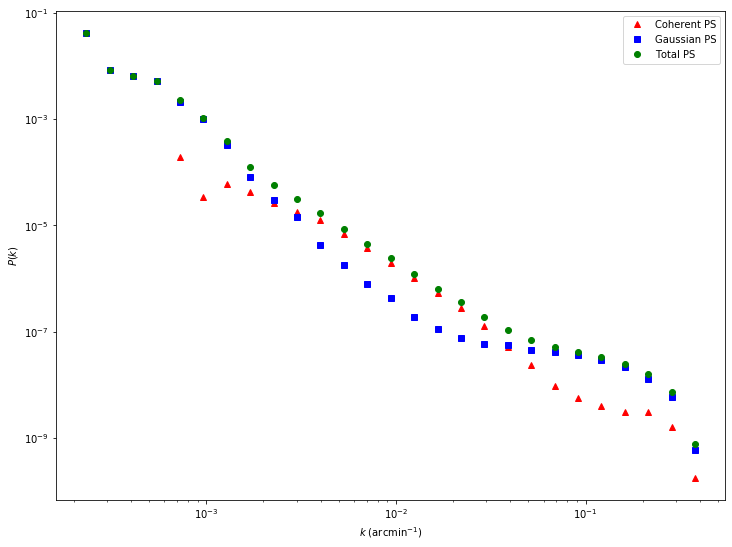

In [8]:
plt.figure(figsize=(12,9))
plt.plot(wav_k, S1aQ[1,:],'^',color='red',label='Coherent PS')
plt.plot(wav_k, S1aQ[2,:],'s',color='blue',label='Gaussian PS')
plt.plot(wav_k, S1aQ[0,:],'o',color='green',label='Total PS')
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r"$k$ (arcmin$^{-1}$)")
plt.ylabel(r"$P(k)$")
plt.legend()

INFO: Auto-setting vmin to -9.027e-04 [aplpy.core]
INFO: Auto-setting vmax to  1.759e-03 [aplpy.core]
INFO: Auto-setting vmin to -3.705e-04 [aplpy.core]
INFO: Auto-setting vmax to  1.215e-03 [aplpy.core]
INFO: Auto-setting vmin to -7.040e-04 [aplpy.core]
INFO: Auto-setting vmax to  7.453e-04 [aplpy.core]
INFO: Auto-setting vmin to -7.762e-04 [aplpy.core]
INFO: Auto-setting vmax to  6.773e-04 [aplpy.core]


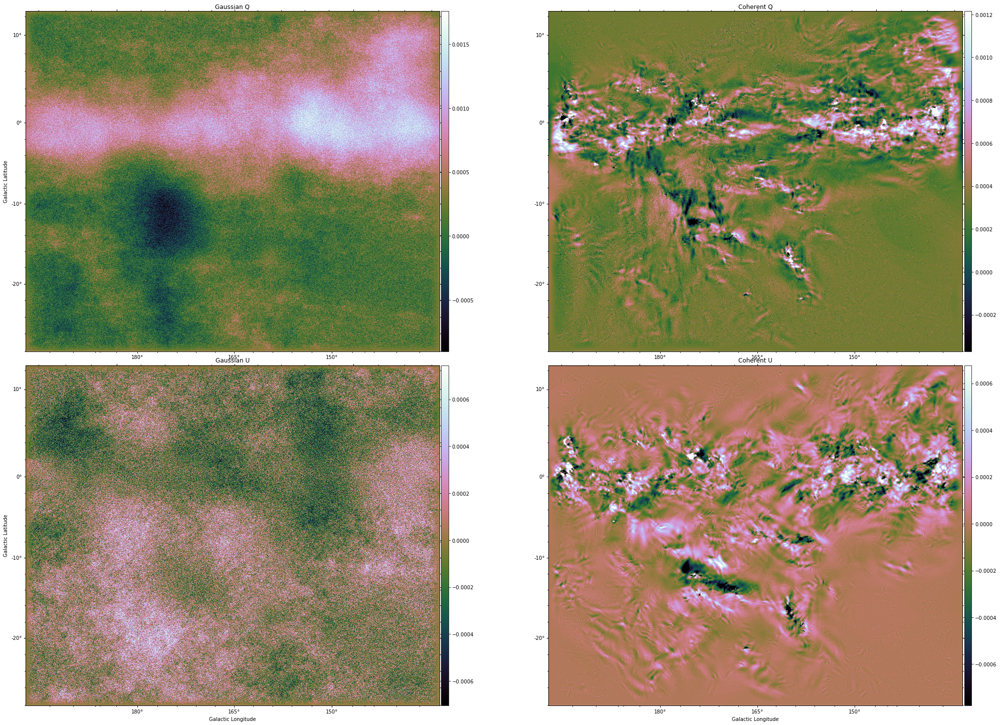

In [23]:
M = wav_k.shape[0]

coherentQ = np.sum(wtQ[M:M+22,:,:],axis=0) + meanQ
GaussianQ = np.sum(wtQ[2*M:3*M,:,:],axis=0) + meanQ
fits.writeto('/Users/robitaij/postdoc/pol_seg/analysis/taurus_Qcohe_cut22.fits',coherentQ.real,\
             QHDU[0].header,overwrite=True)
fits.writeto('/Users/robitaij/postdoc/pol_seg/analysis/taurus_Qgauss.fits',GaussianQ.real,\
             QHDU[0].header,overwrite=True)

coherentU = np.sum(wtU[M:M+22,:,:],axis=0) + meanU
GaussianU = np.sum(wtU[2*M:3*M,:,:],axis=0) + meanU
fits.writeto('/Users/robitaij/postdoc/pol_seg/analysis/taurus_Ucohe_cut22.fits',coherentU.real,\
             UHDU[0].header,overwrite=True)
fits.writeto('/Users/robitaij/postdoc/pol_seg/analysis/taurus_Ugauss.fits',GaussianU.real,\
             UHDU[0].header,overwrite=True)

fig_all = plt.figure(1, figsize=(30,20))

fig = aplpy.FITSFigure(fits.PrimaryHDU(GaussianQ.real,header=QHDU[0].header)\
                       , figure=fig_all, convention='calabretta',subplot=(2, 2, 1))
fig.show_colorscale(cmap='cubehelix')
fig.axis_labels.hide_x()
fig.add_colorbar()
fig.set_title('Gaussian Q')

fig = aplpy.FITSFigure(fits.PrimaryHDU(coherentQ.real,header=QHDU[0].header)\
                       , figure=fig_all, convention='calabretta',subplot=(2, 2, 2))
fig.show_colorscale(cmap='cubehelix')
fig.axis_labels.hide_x()
fig.axis_labels.hide_y()
fig.add_colorbar()
fig.set_title('Coherent Q')

fig = aplpy.FITSFigure(fits.PrimaryHDU(GaussianU.real,header=UHDU[0].header)\
                       , figure=fig_all, convention='calabretta',subplot=(2, 2, 3))
fig.show_colorscale(cmap='cubehelix')
fig.add_colorbar()
fig.set_title('Gaussian U')


fig = aplpy.FITSFigure(fits.PrimaryHDU(coherentU.real,header=UHDU[0].header)\
                       , figure=fig_all, convention='calabretta',subplot=(2, 2, 4))
fig.show_colorscale(cmap='cubehelix')
fig.axis_labels.hide_y()
fig.add_colorbar()
fig.set_title('Coherent U')


fig_all.tight_layout()

#fileout = '/Users/robitaij/postdoc/talks/NIKA2/figures/taurus_mos.pdf'
#fig_all.canvas.print_figure(fileout,dpi=150,bbox_inches='tight')

INFO: Auto-setting vmin to -1.328e-04 [aplpy.core]
INFO: Auto-setting vmax to  1.681e-03 [aplpy.core]
INFO: Auto-setting vmin to -6.578e-05 [aplpy.core]
INFO: Auto-setting vmax to  1.416e-03 [aplpy.core]
INFO: Auto-setting vmin to -1.858e-04 [aplpy.core]
INFO: Auto-setting vmax to  2.669e-03 [aplpy.core]


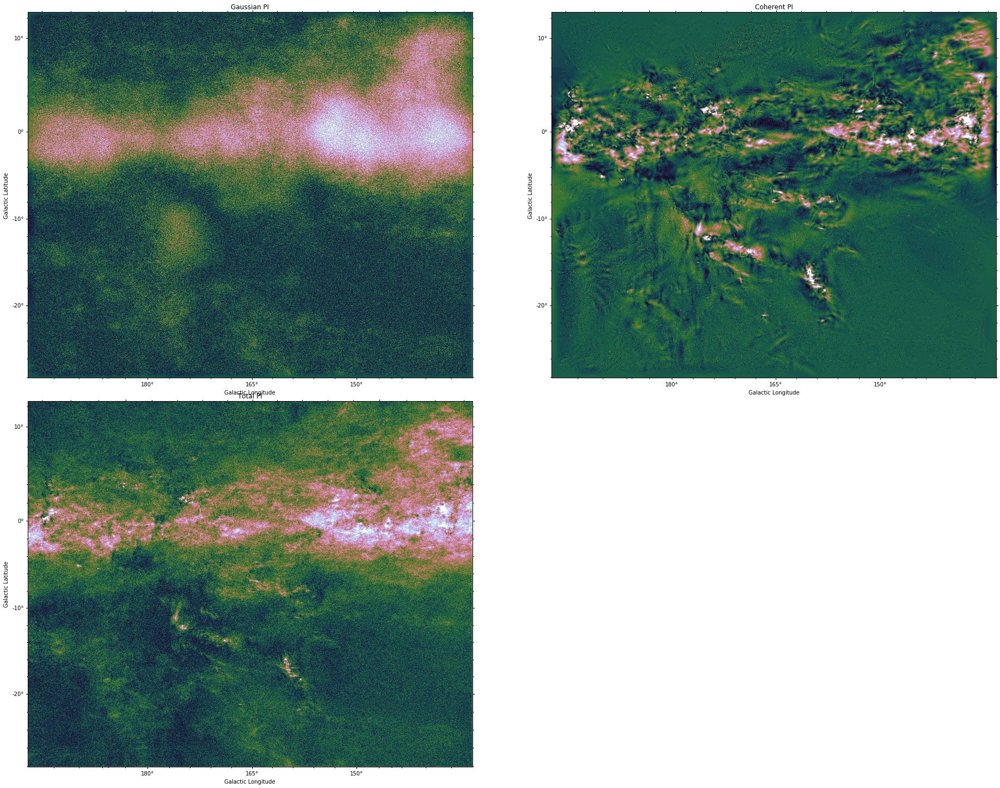

In [24]:
PI = np.sqrt((Qim+meanQ)**2. + (Uim+meanU)**2.)
PIg = np.sqrt(GaussianQ.real**2. + GaussianU.real**2.)
PIc = np.sqrt(coherentQ.real**2. + coherentU.real**2.)

fig_all = plt.figure(1, figsize=(30,20))

fig1 = aplpy.FITSFigure(fits.PrimaryHDU(PIg,header=UHDU[0].header), figure=fig_all, convention='calabretta',subplot=(2,2,1))
fig1.show_colorscale(cmap='cubehelix')
fig1.set_title('Gaussian PI')
#########
fig2 = aplpy.FITSFigure(fits.PrimaryHDU(PIc,header=UHDU[0].header), figure=fig_all, convention='calabretta',subplot=(2,2,2))
fig2.show_colorscale(cmap='cubehelix')
fig2.set_title('Coherent PI')
#########
fig3 = aplpy.FITSFigure(fits.PrimaryHDU(PI,header=UHDU[0].header), figure=fig_all, convention='calabretta',subplot=(2,2,3))
fig3.show_colorscale(cmap='cubehelix')
fig3.set_title('Total PI')

fig_all.tight_layout()

In [13]:
from pol_vec import show_vectors

INFO: Auto-setting vmin to -1.897e-05 [aplpy.core]
INFO: Auto-setting vmax to  2.443e-04 [aplpy.core]


<Figure size 2160x2160 with 0 Axes>

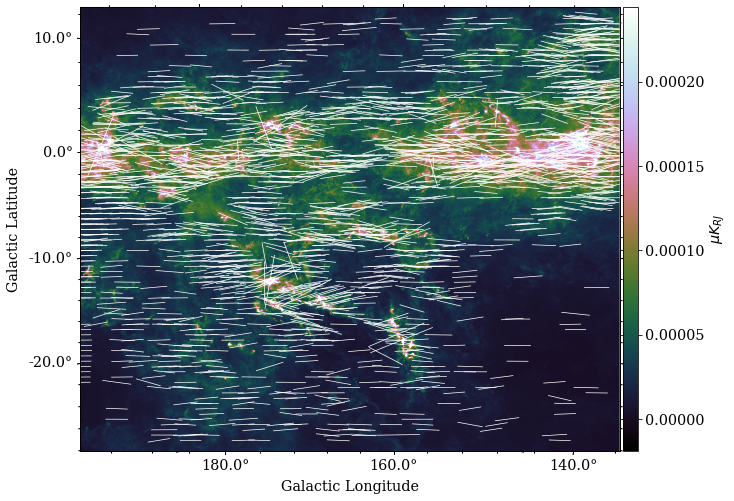

In [17]:
plt.figure(figsize=(30,30))
fig = aplpy.FITSFigure('/Users/robitaij/postdoc/Planck/HFI_tau353_taurus_cut.fits'\
                       , convention='calabretta')
fig.show_colorscale(cmap='cubehelix')
fig.tick_labels.set_xformat('dd.d')
fig.tick_labels.set_yformat('dd.d')
fig.add_colorbar()
fig.colorbar.set_axis_label_text(r'$\mu K_{RJ}$')
fig.tick_labels.set_font(family='serif'\
                      , style='normal', variant='normal', size='x-large')
fig.axis_labels.set_font(family='serif'\
                     , style='normal', variant='normal', size='x-large')
fig.colorbar.set_font(family='serif'\
                             , style='normal', variant='normal', size='x-large')
fig.colorbar.set_axis_label_font(family='serif'\
                             , style='normal', variant='normal', size='x-large')

#Polarisation vectors
#--------------------------------------------

QfP = '/Users/robitaij/postdoc/pol_seg/analysis/taurus_Qcohe.fits'
UfP = '/Users/robitaij/postdoc/pol_seg/analysis/taurus_Ucohe.fits'

QaP=fits.open(QfP)
UaP=fits.open(UfP)
QP=QaP[0].data
UP=UaP[0].data

tresh = 4.e-4

amp = np.zeros(QP.shape)
angl = np.zeros(QP.shape)
amp[np.abs(QP) > tresh] = np.absolute(QP[np.abs(QP) > tresh] + UP[np.abs(QP) > tresh]*1j)*1.e5
#amp = np.zeros((QP.shape[0],QP.shape[1]))+15.0
angl[np.abs(QP) > tresh] = 0.5 * np.arctan2(-UP[np.abs(QP) > tresh],QP[np.abs(QP) > tresh])#Respect the WMAP convention

#linelist = show_vectors(fig,amp,angl,step=25,scale=2e4,rotate=np.pi/2.,cutoff=0.)
linelist = show_vectors(fig,amp,angl,step=20,scale=1,rotate=np.pi/2.,cutoff=0.)
fig.show_lines(linelist,layer='Planck',color='white', linewidths=0.7)

In [8]:
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wtQ.npy', wtQ)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S11aQ.npy', S11aQ)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wav_k.npy', wav_k)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S1aQ.npy', S1aQ)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_qQ.npy', qQ)

np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_wtU.npy', wtU)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S11aU.npy', S11aU)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_S1aU.npy', S1aU)
np.save('/Users/robitaij/postdoc/pol_seg/analysis/taurus_qU.npy', qU)

## Zoom on Taurus

INFO: Auto-setting vmin to -2.572e-05 [aplpy.core]
INFO: Auto-setting vmax to  3.846e-04 [aplpy.core]


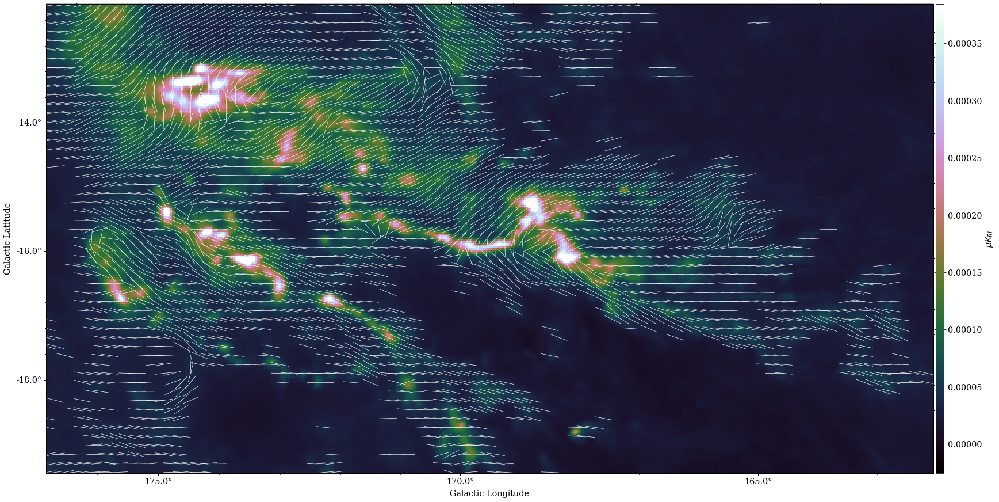

In [57]:
tauf = '/Users/robitaij/postdoc/Planck/HFI_tau353_taurus_cut2.fits'
tauHDU=fits.open(tauf)
tau=tauHDU[0].data

fig_all = plt.figure(figsize=(30,15))
fig = aplpy.FITSFigure(fits.PrimaryHDU(tau,header=tauHDU[0].header)\
                       , convention='calabretta', figure=fig_all)
fig.show_colorscale(cmap='cubehelix')
fig.tick_labels.set_xformat('dd.d')
fig.tick_labels.set_yformat('dd.d')
fig.add_colorbar()
fig.colorbar.set_axis_label_text(r'$\mu K_{RJ}$')
fig.tick_labels.set_font(family='serif'\
                      , style='normal', variant='normal', size='x-large')
fig.axis_labels.set_font(family='serif'\
                     , style='normal', variant='normal', size='x-large')
fig.colorbar.set_font(family='serif'\
                             , style='normal', variant='normal', size='x-large')
fig.colorbar.set_axis_label_font(family='serif'\
                             , style='normal', variant='normal', size='x-large')

#Polarisation vectors
#--------------------------------------------

QfP = '/Users/robitaij/postdoc/pol_seg/analysis/taurus_Qcohe_cut22_zoom.fits'
UfP = '/Users/robitaij/postdoc/pol_seg/analysis/taurus_Ucohe_cut22_zoom.fits'

QaP=fits.open(QfP)
UaP=fits.open(UfP)
QP=QaP[0].data
UP=UaP[0].data

tresh = 3.e-5

amp = np.zeros(QP.shape)
angl = np.zeros(QP.shape)
#amp[tau > tresh] = np.absolute(QP[tau > tresh] + UP[tau > tresh]*1j)*1.e5
amp[tau > tresh] = 1.0
angl[tau > tresh] = 0.5 * np.arctan2(-UP[tau > tresh],QP[tau > tresh])#Respect the WMAP convention
#angl = 0.5 * np.arctan2(-UP,QP)#Respect the WMAP convention

#linelist = show_vectors(fig,amp,angl,step=25,scale=2e4,rotate=np.pi/2.,cutoff=0.)
linelist = show_vectors(fig,amp,angl,step=5,scale=5.0,rotate=np.pi/2.,cutoff=0.)
fig.show_lines(linelist,layer='Planck',color='white', linewidths=0.7)

In [ ]:
from IPython.display import Image

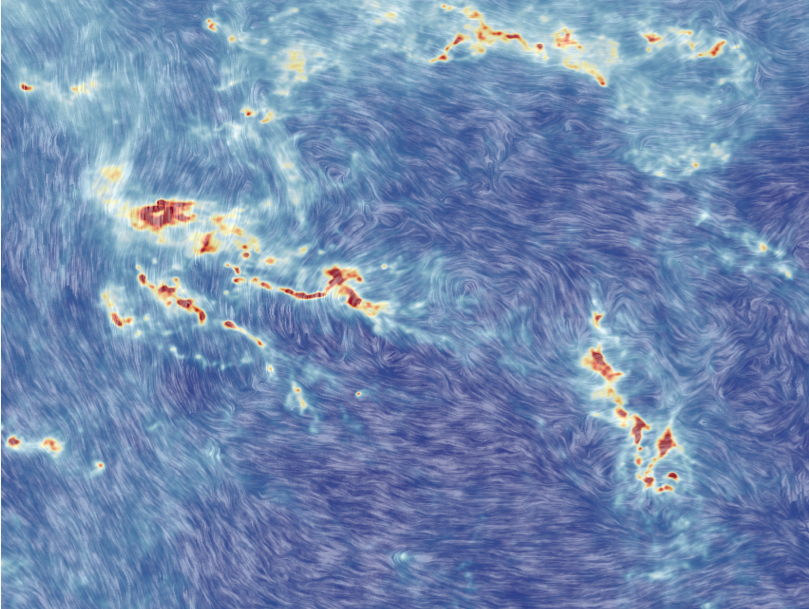

In [62]:
Image(filename = "./Taurus_lic_tot.png", width = 600, height = 300)

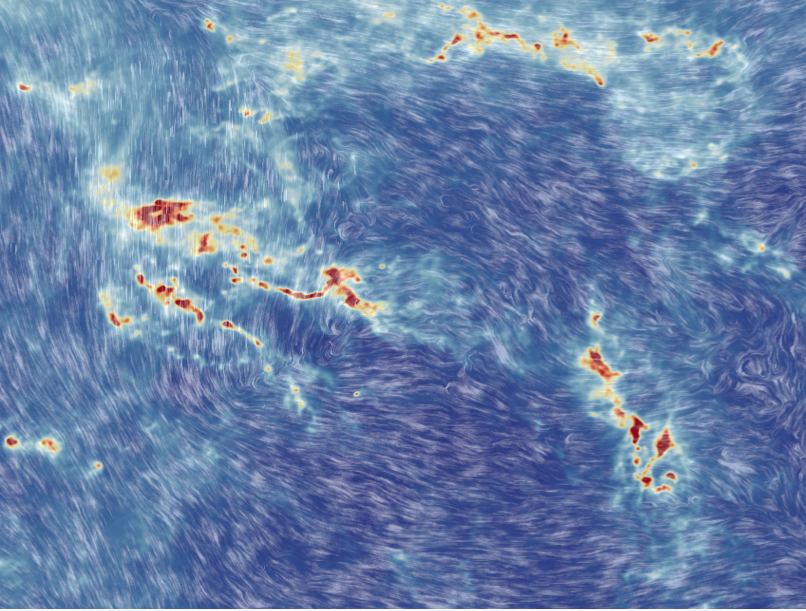

In [63]:
Image(filename = "./Taurus_lic_gauss.png", width = 600, height = 300)